In [1]:
from glob import glob
import pandas as pd
import os
from tqdm import tqdm as tqdm 
from IPython.display import Image
from pathlib import Path
import imageio
import moviepy.video.io.ImageSequenceClip

In [2]:
subject_mapping = {"m00183": "sub_1",
                   "m00184": "sub_2",
                   "m00185": "sub_3",
                   "m00187": "sub_4",
                   "m00188": "sub_5",
                   "m00191": "sub_6",
                   "m00192": "sub_7",
                   "m00193": "sub_8",
                   "m00194": "sub_9",
                   "m00195": "sub_10",
                  }

In [3]:
task_name_mapping = {
        'onset': 'Sentence Onset',
        'speech': 'Speech',
        'volume': 'Volume', 
        'pitch': 'Pitch',
        'speaker': 'Speaker Identity',
        'delta_volume': 'Delta Volume',
        'delta_pitch': 'Delta Pitch',
        'gpt2_surprisal': 'GPT-2 Surprisal',
        'word_length': 'Word Length',
        'word_gap': 'Inter-word Gap',
        'word_index': 'Word Position',
        'word_head_pos': 'Head Word Position',
        'word_part_speech': 'Part of Speech',
        'frame_brightness': 'Frame Brightness',
        'global_flow': 'Global Optical Flow',
        'local_flow': 'Local Optical Flow',
        'global_flow_angle': 'Global Flow Angle',
        'local_flow_angle': 'Local Flow Angle',
        'face_num': 'Number of Faces',
    }

In [4]:
task_order =  ['onset', 'speech', 'volume', 'pitch', 'speaker', 'delta_volume', 'delta_pitch', 'gpt2_surprisal', 'word_length', 'word_gap', 'word_index', 'word_head_pos', 'word_part_speech', 'frame_brightness', 'global_flow', 'local_flow', 'global_flow_angle', 'local_flow_angle', 'face_num']

In [5]:
from tqdm import tqdm
import h5py
import math
import matplotlib
# matplotlib.use('Agg') # Must be before importing matplotlib.pyplot or pylab!
import matplotlib.pyplot as plt
import copy
import numpy as np
import os
import json
import scipy.stats
import time
from types import SimpleNamespace
import random
import pandas as pd
from mpl_toolkits.axes_grid1 import make_axes_locatable

matlab_xlim = (-108.0278, 108.0278)
matlab_ylim = (-72.9774, 72.9774)

save_dir = 'brain_plotting/'
base_path = 'brain_plotting/'
left_hem_file_name = 'left_hem_clean.png'
right_hem_file_name = 'right_hem_clean.png'
coords_file_name = 'elec_coords_full.csv'
correlations_file = 'lag_correlation.json'

left_hem_img = plt.imread(os.path.join(base_path, left_hem_file_name))
right_hem_img = plt.imread(os.path.join(base_path, right_hem_file_name))
coords_df = pd.read_csv(os.path.join(base_path, coords_file_name))
split_elec_id = coords_df['ID'].str.split('-')
coords_df['Subject'] = [subject_mapping[t[0]] for t in split_elec_id]
coords_df['Electrode'] = [t[1] for t in split_elec_id]

# # Scale Matlab electrode locations to Python format
def scale(x, s, d):
    return -(x - d) * s

x_scale = left_hem_img.shape[1] / (matlab_xlim[1] - matlab_xlim[0])
y_scale_l = left_hem_img.shape[0] / (matlab_ylim[1] - matlab_ylim[0])

y_scale_r = right_hem_img.shape[0] / (matlab_ylim[1] - matlab_ylim[0])

scaled_coords_df = coords_df.copy()

# scale left hemisphere coordinates
scaled_coords_df.loc[scaled_coords_df['Hemisphere'] == 1, 'X'] = coords_df.loc[coords_df['Hemisphere'] == 1, 'X'].apply(lambda x: scale(x, x_scale, matlab_xlim[1]))
scaled_coords_df.loc[scaled_coords_df['Hemisphere'] == 1, 'Y'] = coords_df.loc[coords_df['Hemisphere'] == 1, 'Y'].apply(lambda x: scale(x, y_scale_l, matlab_ylim[1]))

# scale right hemisphere coordinates
scaled_coords_df.loc[scaled_coords_df['Hemisphere'] == 0, 'X'] = coords_df.loc[coords_df['Hemisphere'] == 0, 'X'].apply(lambda x: -scale(x, y_scale_r, matlab_xlim[0]))
scaled_coords_df.loc[scaled_coords_df['Hemisphere'] == 0, 'Y'] = coords_df.loc[coords_df['Hemisphere'] == 0, 'Y'].apply(lambda x: scale(x, y_scale_r, matlab_ylim[1]))

# scaled_coords_df[]
scaled_coords_df["ID"] = scaled_coords_df.Electrode + "-" + scaled_coords_df.Subject

/afs/csail.mit.edu/u/c/czw/.config/matplotlib is not a writable directory
Matplotlib created a temporary cache directory at /tmp/matplotlib-9a2um6d7 because there was an issue with the default path (/afs/csail.mit.edu/u/c/czw/.config/matplotlib); it is highly recommended to set the MPLCONFIGDIR environment variable to a writable directory, in particular to speed up the import of Matplotlib and to better support multiprocessing.


In [6]:
# results_root = "/storage/czw/linear_voltage_single_electrode_SS_SM_prototype/linear_voltage_single_electrode"
results_root = "/storage/czw/btbench/single_electrode_btbench_full/eval_results_full_SS_SM/linear_voltage_single_electrode"

In [7]:
def get_test_results(results, eval_name):
    eval_results = results["evaluation_results"]
    assert len(eval_results.keys()) == 1
    records = []
    for subject_trial in eval_results:
        subject = subject_trial.split("_")[0][len("btbank"):]
        trial = subject_trial.split("_")[1]
        subject_trial_results = eval_results[subject_trial]['electrode']
        for electrode in subject_trial_results:
            electrode_results = subject_trial_results[electrode]
            time_bin_results = electrode_results["time_bins"]
            for time_bin in time_bin_results:
                time_bin_start = time_bin['time_bin_start']
                fold_results = time_bin['folds']
                avg_test = np.mean([f['test_roc_auc'] for f in fold_results])
                records.append({
                    "subject": subject,
                    "trial": trial,
                    "ID": f'{electrode}-sub_{subject}',
                    "electrode": electrode,
                    "avg_test": avg_test,
                    "time_bin": time_bin_start,
                    "task": eval_name
                })
        return records

# Load the single electrode results

In [8]:
all_records = []
all_results_paths = glob(os.path.join(results_root, "*"))
for path in tqdm(all_results_paths):
    name = Path(path).stem
    sub_id = name.split("_")[1][len("btbank"):]
    trial_id = name.split("_")[2]
    eval_name = "_".join(name.split("_")[3:])
    with open(path, "r") as f:
        results = json.load(f)
        test_results = get_test_results(results, eval_name)
    all_records += test_results
results_df = pd.DataFrame.from_records(all_records)

100%|██████████████████████████████████████████████████████████████████████████████████| 494/494 [00:28<00:00, 17.40it/s]


Basically, we have decoding results for each task and each electrode and each time bin

In [9]:
results_df.head()

,subject,trial,ID,electrode,avg_test,time_bin,task
0,9,0,T1b1-sub_9,T1b1,0.481273,-0.500,speech
1,9,0,T1b1-sub_9,T1b1,0.477107,-0.375,speech
2,9,0,T1b1-sub_9,T1b1,0.494581,-0.250,speech
3,9,0,T1b1-sub_9,T1b1,0.479030,-0.125,speech
4,9,0,T1b1-sub_9,T1b1,0.481981,0.000,speech


# Plotting code

In [10]:
from matplotlib.colors import LinearSegmentedColormap, Normalize

grey_to_red = LinearSegmentedColormap.from_list('grey_to_red', [(0.0, 'grey'), (0.3, 'grey'), (0.4, 'yellow'), (1.0, 'red')])

In [11]:
def inverse_scale(x):
    lower = 0.49
    return np.exp(x) + lower

In [12]:
def log_scale(x):
    lower = 0.49
    epsilon = 1e-4
    return np.log(max((x - lower), epsilon))

In [13]:
import seaborn as sns
def plot_electrodes(plot_df, ax=None, hemisphere="left", title=None, cmap=grey_to_red, vmax=0.9):
    plot_df = plot_df.dropna() #TODO NOTE
    plot_df = plot_df.sort_values(by='avg_test', ascending=True)

    ax.set_aspect('equal')

    if hemisphere=="left":
        ax.imshow(left_hem_img, alpha=0.7)
        plot_df = plot_df[plot_df.Hemisphere==1]
    elif hemisphere=="right":
        ax.imshow(right_hem_img, alpha=0.7)
        plot_df = plot_df[plot_df.Hemisphere==0]


    ax.axis('off')
    assert hemisphere in ["left", "right"]


    plot_title = f'{hemisphere} hemisphere'

    if title:
        plot_title += f' {title}'

    all_x = plot_df['X']
    all_y = plot_df['Y']
    color = plot_df['avg_test']
    assert(list(sorted(color))==list(color))

    lower = 0.49
    epsilon = 1e-4
    scale = lambda x: (np.log(max((x - lower), epsilon)))

    sc = ax.scatter(all_x, all_y,
                s=50,
                linewidths=1,
                c=color,
                edgecolors="black",
                clip_on=False,
                # cmap="viridis",
                cmap=cmap,
                vmin=log_scale(0.50),
                vmax=log_scale(vmax),
                )
    return sc

In [14]:
import matplotlib.gridspec as gridspec
from matplotlib.ticker import FuncFormatter

def make_plot(time):
    
    fig = plt.figure(figsize=(40, 12))
    
    num_cols = 5
    num_rows = 4
    
    outer = gridspec.GridSpec(num_rows, num_cols, wspace=0.2, hspace=0.2)
    
    # Loop through each subplot and add a simple plot or title
    for i in range(num_rows):
        for j in range(num_cols):
            # Index in outer grid
            outer_idx = i * num_cols + j
            
            if i*num_cols+j >= 19:
                ax = fig.add_subplot(outer[num_rows*num_cols - 1])
                cbar = fig.colorbar(sc, ax=ax, orientation='horizontal')
                cbar.ax.set_position([0.77,0.12,0.14,0.1])  # or use cbar.ax.set_position([...]) for fine-tuning
                cbar.ax.tick_params(labelsize=25)
                cbar.ax.xaxis.set_major_formatter(FuncFormatter(lambda val, pos: f"{inverse_scale(val):.02}"))
                cbar.set_label("ROC-AUC (log scale)", fontsize=25)
                ax.set_axis_off()
                continue
                
            # Define inner 2x1 grid within this cell
            inner = gridspec.GridSpecFromSubplotSpec(
                1, 2, subplot_spec=outer[outer_idx], hspace=0.1
            )
                
            for k in range(2):
                ax = fig.add_subplot(inner[k])
                task = task_order[i*num_cols+j]
                task_df = results_df[results_df.time_bin==time].groupby(['task','ID']).max(['avg_test']).loc[task].copy()
                
                task_df.loc[:,'avg_test'] = task_df['avg_test'].apply(log_scale)
    
                merged_df = pd.merge(scaled_coords_df, task_df, on="ID", how="left")
                hem = ["left","right"][k]
                sc = plot_electrodes(merged_df, hemisphere=hem, ax=ax, title=task)
                
                if k == 0:
                    ax.set_title(task_name_mapping[task], fontsize=24, loc='left')
                    
    plt.tight_layout()
    gif_root = f"timed_gif_frames"
    Path(gif_root).mkdir(exist_ok=True, parents=True)
    plt.savefig(os.path.join(gif_root, f"{time}.png"))

In [15]:
times = list(np.arange(-0.5, 1.25, 0.125))

This will create a bunch of frames, one for each time step, and write them to a file

/tmp/ipykernel_339271/3025923679.py:48: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
/tmp/ipykernel_339271/3025923679.py:48: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
/tmp/ipykernel_339271/3025923679.py:48: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
/tmp/ipykernel_339271/3025923679.py:48: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
/tmp/ipykernel_339271/3025923679.py:48: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
/tmp/ipykernel_339271/3025923679.py:48: UserWarning: This figure includes Axes that are not compatible with tight_layout, so resul

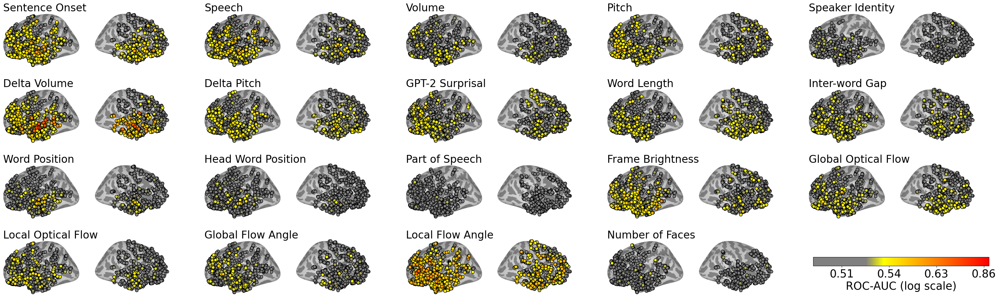

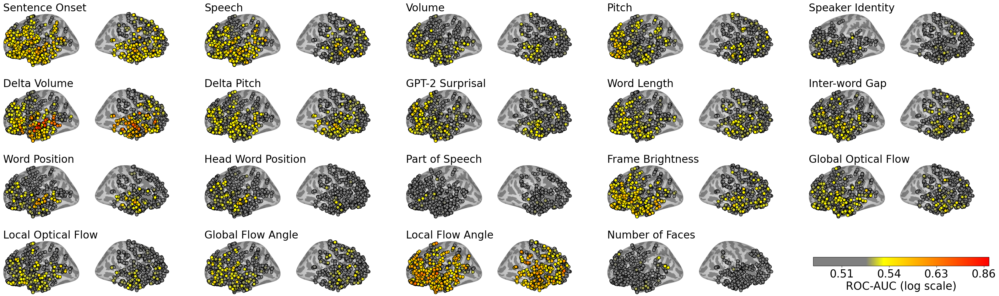

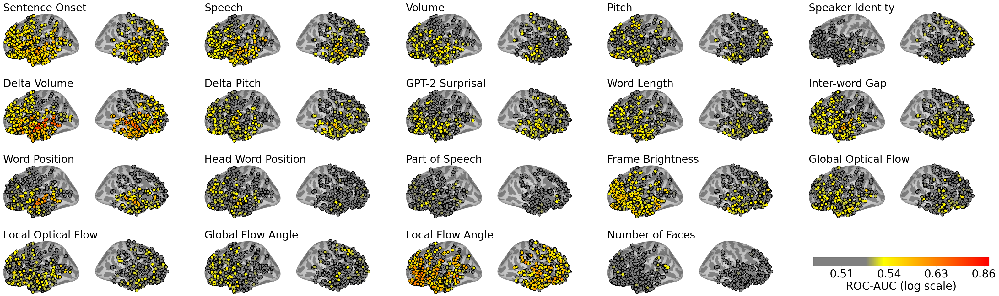

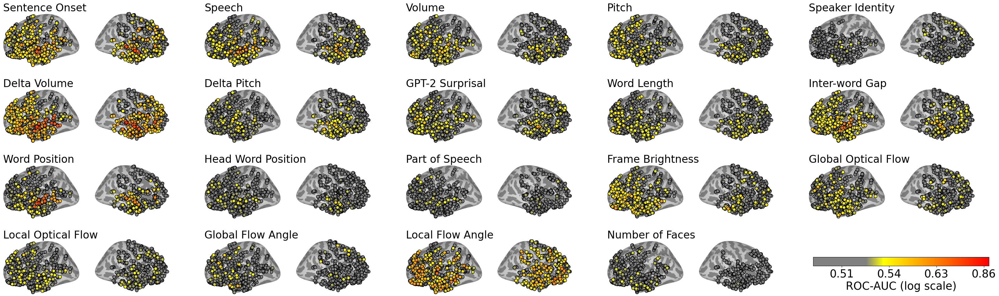

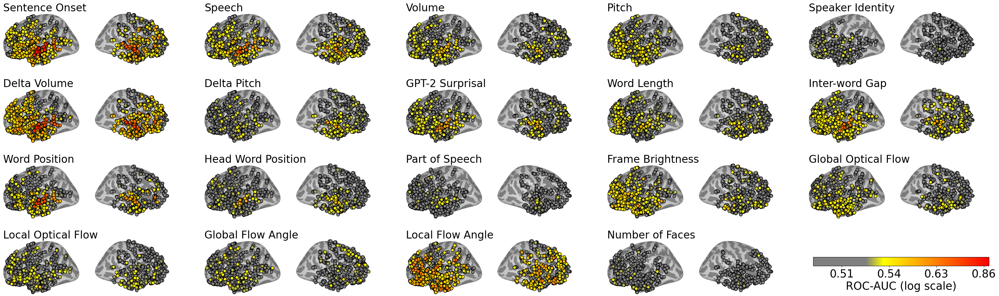

...

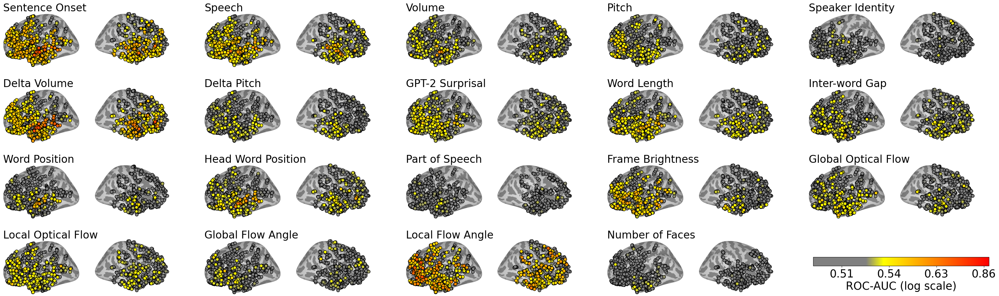

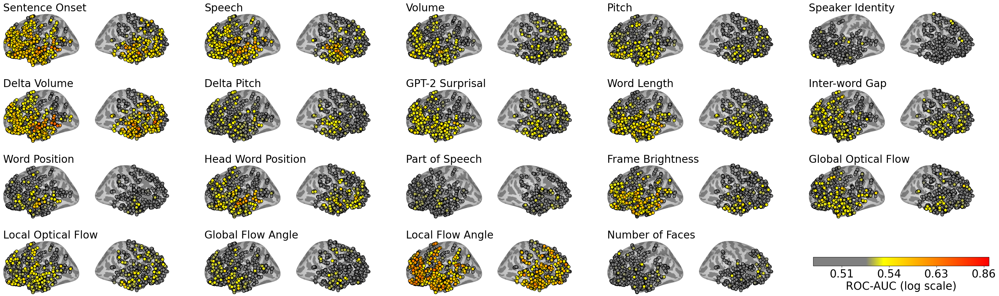

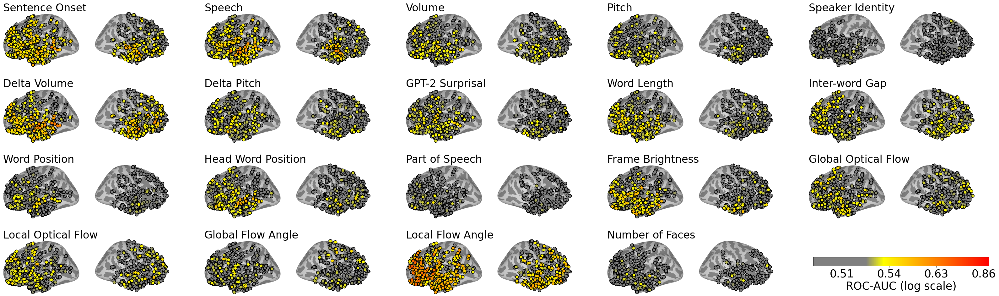

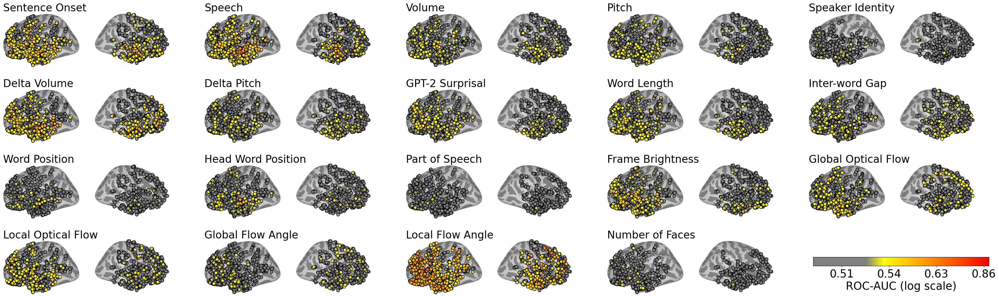

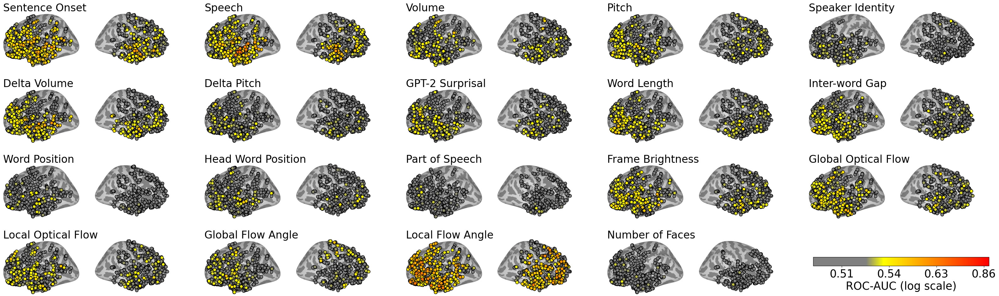

In [16]:
for time in times:
    make_plot(time)

In [17]:
filenames = []
for time in times:
    filenames.append(f"timed_gif_frames/{time}.png")

In [18]:
images = []
for filename in filenames:
    images.append(imageio.imread(filename))

fps = 4
clip = moviepy.video.io.ImageSequenceClip.ImageSequenceClip(filenames[:-1], fps=fps)
clip.write_videofile('my_video_all.mp4')

/tmp/ipykernel_339271/3399114089.py:3: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  images.append(imageio.imread(filename))


MoviePy - Building video my_video_all.mp4.
MoviePy - Writing video my_video_all.mp4



MoviePy - Done !
MoviePy - video ready my_video_all.mp4


# Make a movie for just one task

In [19]:
import matplotlib.gridspec as gridspec
from matplotlib.ticker import FuncFormatter

def make_plot_single(time, task):
    
    fig = plt.figure(figsize=(8, 4))
    
    num_cols = 1
    num_rows = 1
    
    outer = gridspec.GridSpec(num_rows, num_cols, wspace=0.2, hspace=0.2)
    
    # Loop through each subplot and add a simple plot or title
    for i in range(num_rows):
        for j in range(num_cols):
            # Index in outer grid
            outer_idx = i * num_cols + j
            
            if i*num_cols+j >= 19:
                ax = fig.add_subplot(outer[num_rows*num_cols - 1])
                cbar = fig.colorbar(sc, ax=ax, orientation='horizontal')
                cbar.ax.set_position([0.77,0.12,0.14,0.1])  # or use cbar.ax.set_position([...]) for fine-tuning
                cbar.ax.tick_params(labelsize=25)
                cbar.ax.xaxis.set_major_formatter(FuncFormatter(lambda val, pos: f"{inverse_scale(val):.02}"))
                cbar.set_label("ROC-AUC (log scale)", fontsize=25)
                ax.set_axis_off()
                continue
                
            # Define inner 2x1 grid within this cell
            inner = gridspec.GridSpecFromSubplotSpec(
                1, 2, subplot_spec=outer[outer_idx], hspace=0.1
            )
                
            for k in range(2):
                ax = fig.add_subplot(inner[k])
                task = task_order[i*num_cols+j]
                task_df = results_df[results_df.time_bin==time].groupby(['task','ID']).max(['avg_test']).loc[task].copy()
                
                task_df.loc[:,'avg_test'] = task_df['avg_test'].apply(log_scale)
    
                merged_df = pd.merge(scaled_coords_df, task_df, on="ID", how="left")
                hem = ["left","right"][k]
                sc = plot_electrodes(merged_df, hemisphere=hem, ax=ax, title=task)
                
                if k == 0:
                    ax.set_title(task_name_mapping[task], fontsize=24, loc='left')
                    
    plt.tight_layout()
    gif_root = f"single_task_timed_gif_frames"
    Path(gif_root).mkdir(exist_ok=True, parents=True)
    plt.savefig(os.path.join(gif_root, f"{time}.png"))

/tmp/ipykernel_339271/3634323933.py:48: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
/tmp/ipykernel_339271/3634323933.py:48: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
/tmp/ipykernel_339271/3634323933.py:48: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
/tmp/ipykernel_339271/3634323933.py:48: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
/tmp/ipykernel_339271/3634323933.py:48: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
/tmp/ipykernel_339271/3634323933.py:48: UserWarning: This figure includes Axes that are not compatible with tight_layout, so resul

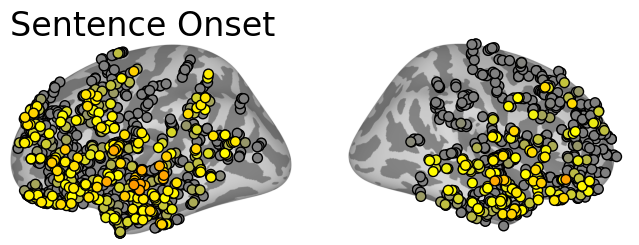

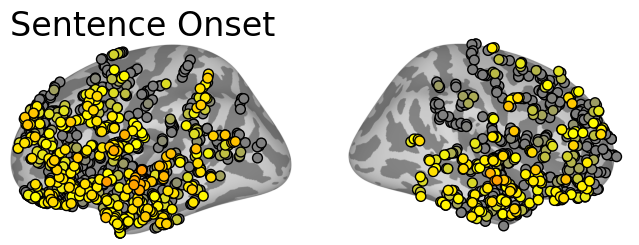

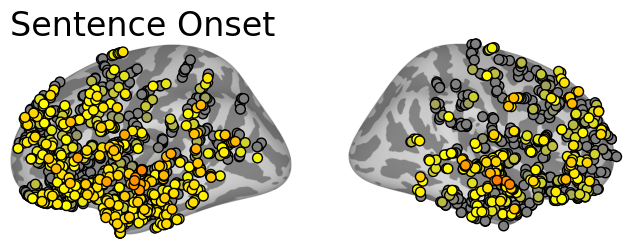

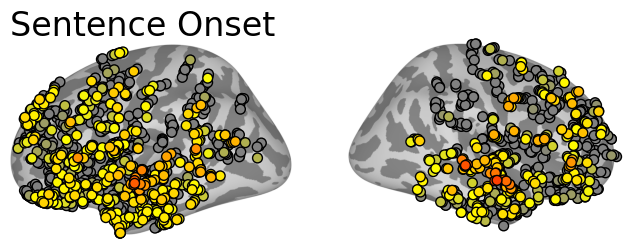

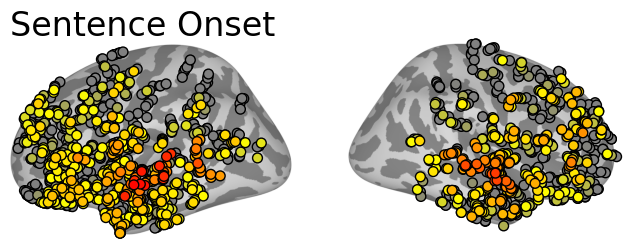

...

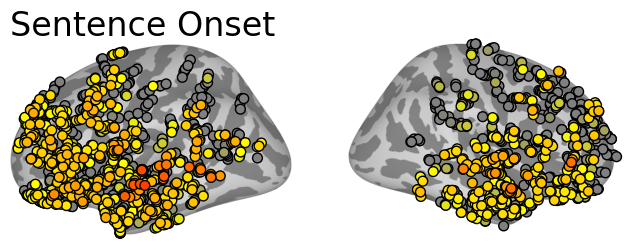

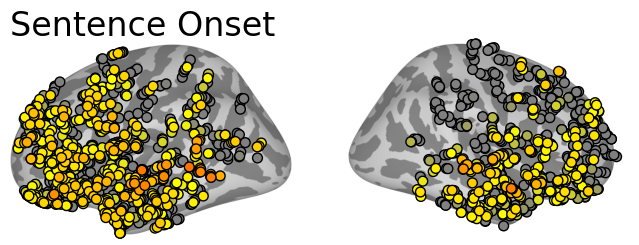

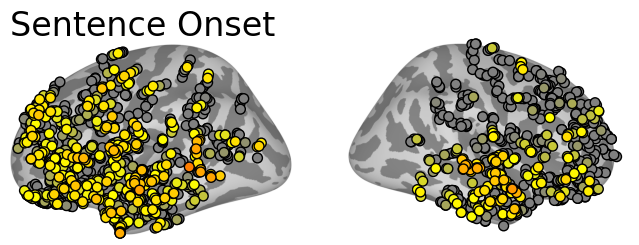

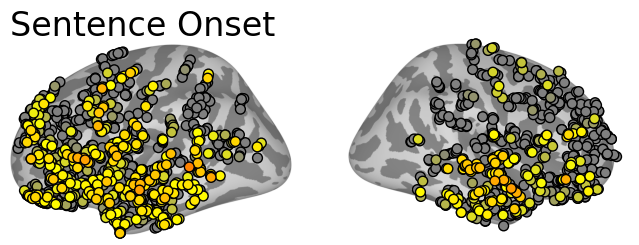

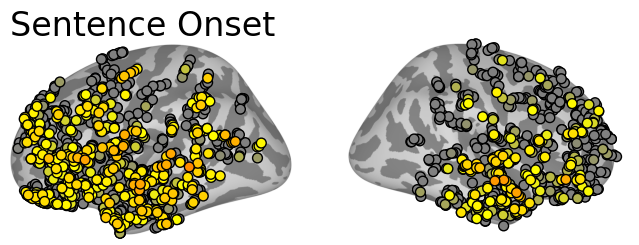

In [20]:
task = "surprisal"
for time in times:
    make_plot_single(time, task)

In [21]:
filenames = []
for time in times:
    filenames.append(f"single_task_timed_gif_frames/{time}.png")

In [22]:
images = []
for filename in filenames:
    images.append(imageio.imread(filename))

fps = 4
clip = moviepy.video.io.ImageSequenceClip.ImageSequenceClip(filenames[:-1], fps=fps)
clip.write_videofile('my_video.mp4')

/tmp/ipykernel_339271/636337747.py:3: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  images.append(imageio.imread(filename))


MoviePy - Building video my_video.mp4.
MoviePy - Writing video my_video.mp4



MoviePy - Done !
MoviePy - video ready my_video.mp4


#  View the video

In [23]:
from IPython.display import Video

Video("my_video.mp4")

# plot a few frames

/tmp/ipykernel_339271/2856079909.py:45: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


Text(1.0, 1.0, 'GPT-2 Surprisal')

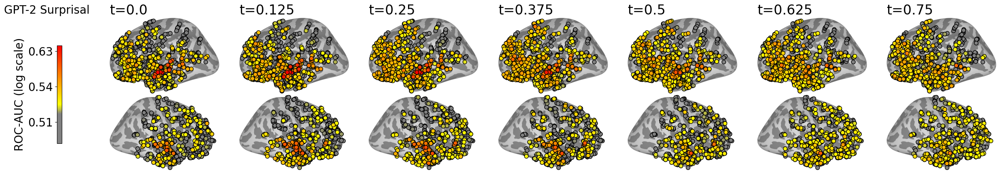

In [24]:
task = "gpt2_surprisal"

fig = plt.figure(figsize=(30, 5))
selected_times = times[3:11]
num_cols = len(selected_times)
num_rows = 1

outer = gridspec.GridSpec(num_rows, num_cols, wspace=0.2, hspace=0.0, width_ratios = [0.3] + [1]*(num_cols-1))

# Loop through each subplot and add a simple plot or title
for i in range(num_rows):
    for j in range(1, num_cols):
        # Index in outer grid
        outer_idx = i * num_cols + j

        # Define inner 2x1 grid within this cell
        inner = gridspec.GridSpecFromSubplotSpec(
            2, 1, subplot_spec=outer[outer_idx], hspace=0.05
        )

        for k in range(2):
            ax = fig.add_subplot(inner[k])
#             print(i*4+j)
            time = selected_times[j]
            task_df = results_df[results_df.time_bin==time].groupby(['task','ID']).max(['avg_test']).loc[task].copy()
            
            scale = lambda x: (np.log(max((x - lower), epsilon)))
            lower = 0.49
            epsilon = 1e-4
            task_df.loc[:,'avg_test'] = task_df['avg_test'].apply(log_scale)

            merged_df = pd.merge(scaled_coords_df, task_df, on="ID", how="left")
            hem = ["left","right"][k]
            sc = plot_electrodes(merged_df, hemisphere=hem, ax=ax, title=task, vmax=0.65)
            
            if k == 0:
                ax.set_title(f"t={time}", fontsize=24, loc='left')

ax = fig.add_subplot(outer[0])
cbar = fig.colorbar(sc, ax=ax, orientation='vertical', location='left')
cbar.ax.tick_params(labelsize=20)
cbar.ax.yaxis.set_major_formatter(FuncFormatter(lambda val, pos: f"{inverse_scale(val):.02}"))
cbar.set_label("ROC-AUC (log scale)", fontsize=20)
ax.set_axis_off()
plt.tight_layout()
plt.title(task_name_mapping[task], loc="right", fontsize=20)

In [25]:
inverse_scale(0.3)

np.float64(1.8398588075760032)

# Plot a few frames for all tasks

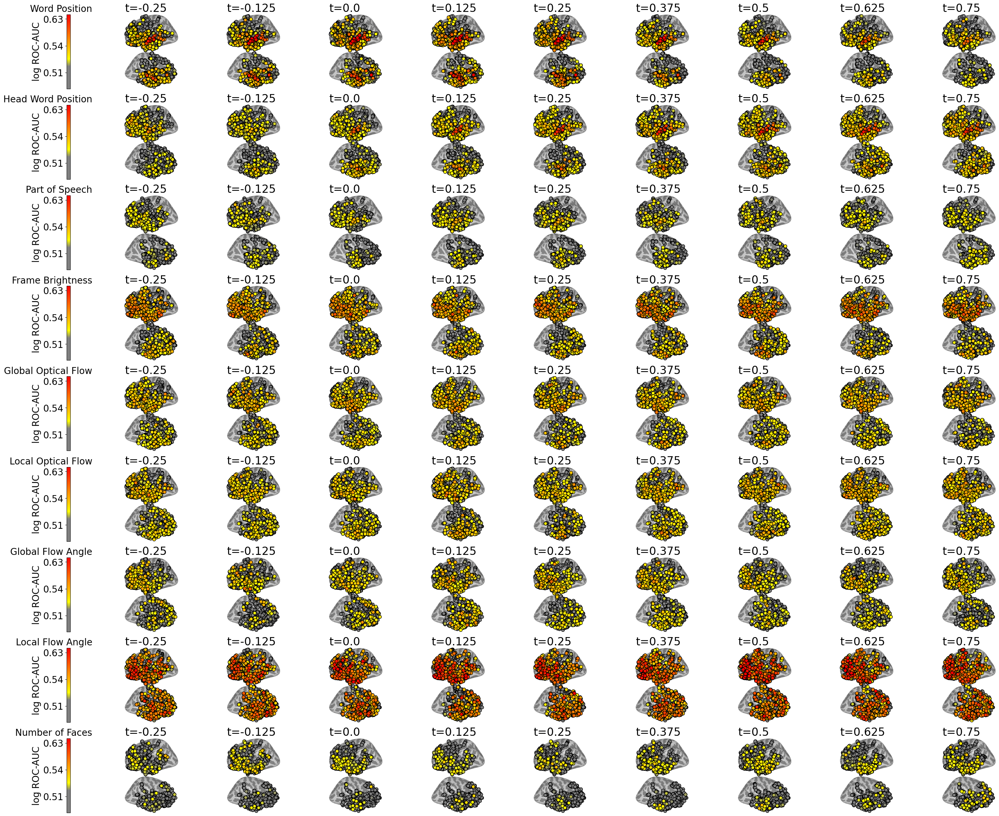

In [26]:
# for task in 
from matplotlib.gridspec import GridSpec

num_tasks = 9
fig = plt.figure(figsize=(30, 5.5*num_tasks))
# selected_times = times[::4]
selected_times = [0, 0.25, 0.5, 0.75]
selected_times = times[1:11]
num_cols = len(selected_times)
num_rows = 1

# num_cols = 2
# num_rows = 1
gs_master = GridSpec(2*num_tasks, 1, figure=fig)



task = "gpt2_surprisal"
for task_i, task in enumerate(task_order[10:10+num_tasks]):
    gs_sub = gs_master[task_i].subgridspec(num_rows, num_cols, wspace=0.2, hspace=0.0, width_ratios = [0.3] + [1]*(num_cols-1))

    # Loop through each subplot and add a simple plot or title
    for i in range(num_rows):
        for j in range(1, num_cols):
            # Index in outer grid
            outer_idx = i * num_cols + j
    
            # Define inner 2x1 grid within this cell
            inner = gridspec.GridSpecFromSubplotSpec(
                2, 1, subplot_spec=gs_sub[outer_idx], hspace=0.05
            )
    
            for k in range(2):
                ax = fig.add_subplot(inner[k])
    #             print(i*4+j)
                time = selected_times[j]
                task_df = results_df[results_df.time_bin==time].groupby(['task','ID']).max(['avg_test']).loc[task].copy()
                
                scale = lambda x: (np.log(max((x - lower), epsilon)))
                lower = 0.49
                epsilon = 1e-4
                task_df.loc[:,'avg_test'] = task_df['avg_test'].apply(log_scale)
    
                # task_df.loc[:,'avg_test'] = np.log(100*task_df['avg_test'])
                merged_df = pd.merge(scaled_coords_df, task_df, on="ID", how="left")
                hem = ["left","right"][k]
                sc = plot_electrodes(merged_df, hemisphere=hem, ax=ax, title=task, vmax=0.65)
    #             ax.set_title(task)
                
                if k == 0:
                    ax.set_title(f"t={time}", fontsize=24, loc='left')
    
    ax = fig.add_subplot(gs_sub[0])
    cbar = fig.colorbar(sc, ax=ax, orientation='vertical', location='left')
    cbar.ax.tick_params(labelsize=20)
    cbar.ax.yaxis.set_major_formatter(FuncFormatter(lambda val, pos: f"{inverse_scale(val):.02}"))
    cbar.set_label("log ROC-AUC", fontsize=20)
    ax.set_axis_off()
    ax.set_title(task_name_mapping[task], loc="right", fontsize=20)

plt.tight_layout()
